### This is suppossed to classify the different problems in the networks

In [201]:
import osmnx as ox
import geopandas as gpd
from shapely.geometry import Point, LineString, MultiPoint
from shapely.ops import polygonize, polygonize_full
import numpy as np
import folium

In [2]:
import momepy as mm
mm.__version__

/Users/gregoriomaya/mambaforge/envs/test/lib/python3.10/site-packages/tqdm/auto.py:22: TqdmWarning: IProgress not found. Please update jupyter and ipywidgets. See https://ipywidgets.readthedocs.io/en/stable/user_install.html
  from .autonotebook import tqdm as notebook_tqdm


'0.5.3+1.g3e8395f'

# Loading data

In [4]:
city = 'Community of Madrid, Spain'
G = ox.graph_from_place(city, 
                        network_type='drive', 
                        simplify = True)
nodes, edges = ox.graph_to_gdfs(G)

#use only the geometry and a basic id as a starting point to homogenize 
edges = gpd.GeoDataFrame(edges.reset_index()['geometry'])
edges = edges.to_crs(2062)

<AxesSubplot:>

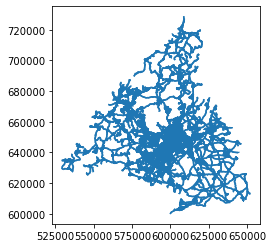

In [9]:
edges.plot()

In [17]:
#saving for future
#filename = 'madrid_2062.gpkg'
#edges.to_file(filename , driver='GPKG', layer='name') 

/Users/gregoriomaya/mambaforge/envs/test/lib/python3.10/site-packages/geopandas/io/file.py:362: FutureWarning: pandas.Int64Index is deprecated and will be removed from pandas in a future version. Use pandas.Index with the appropriate dtype instead.
  pd.Int64Index,


In [ ]:
#loading from file 
edges = gpd.read_file('madrid_2062.gpkg')

# Poligonizing and classifying

In [18]:
# polygonize network
polygonized = polygonize(edges.geometry)
geoms = [g for g in polygonized]
gdf = gpd.GeoDataFrame(geometry=geoms, crs=edges.crs)

In [19]:
# calculate parameters
gdf["area"] = gdf.geometry.area
gdf['log_area'] = np.log(gdf['area'])

gdf["circom"] = mm.CircularCompactness(gdf, "area").series


# select valid and invalid network-net_blocks
possible = gdf.loc[gdf["area"] < max_size]
invalid = possible.loc[(possible["circom"] < circom_max)]

In [26]:
gdf.head()

,geometry,area,circom,log_area
0,"POLYGON ((599776.040 627429.241, 599766.486 62...",1.660603e+06,0.259385,14.322691
1,"POLYGON ((599749.510 633709.916, 599748.687 63...",1.826747e+04,0.038018,9.812877
2,"POLYGON ((591778.970 624932.683, 591786.193 62...",3.882957e+04,0.010722,10.566937
3,"POLYGON ((594275.470 629954.522, 594163.147 62...",1.555440e+04,0.022441,9.652099
4,"POLYGON ((595713.917 626235.567, 595703.129 62...",7.655506e+03,0.033764,8.943180


<AxesSubplot:xlabel='log_area', ylabel='circom'>

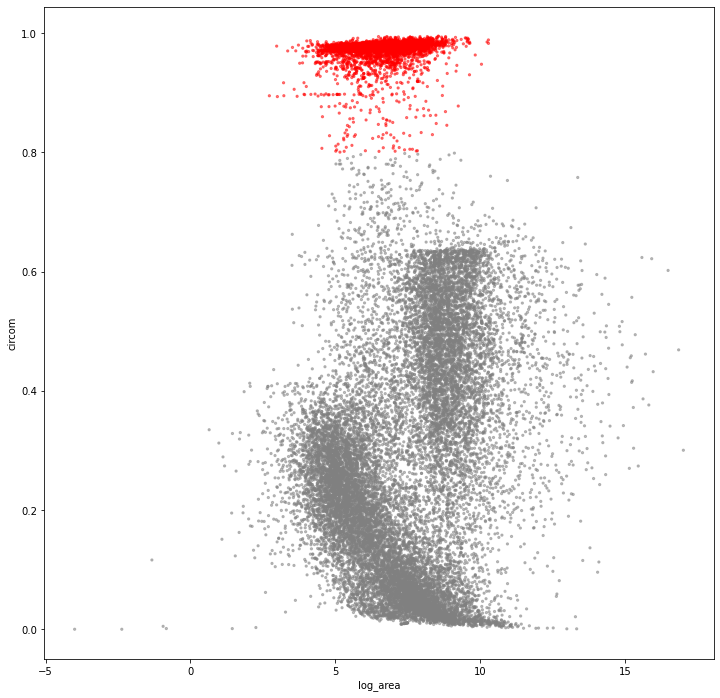

In [75]:
# filter potentially incorrect polygons - TODO
max_size = 10000
size = 5000
circom_max = 0.8
c =  ['r' if x else 'grey' for x in  (gdf.circom > circom_max)] #& (gdf.area < max_size)] 

gdf.plot.scatter(x="log_area", y="circom", 
                 color = c, 
                 marker = '.', 
                 alpha = 0.5,
                figsize=(12, 12))

<AxesSubplot:xlabel='area', ylabel='circom'>

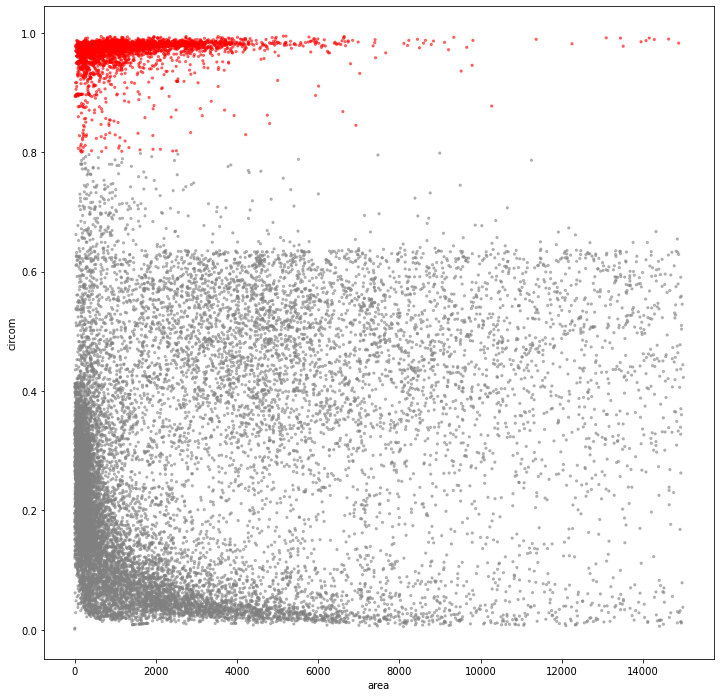

In [95]:
#removing particularly small areas
gdf = gdf[gdf['log_area']>0]
#
gdf_viz = gdf[gdf['area']<15000]

c =  ['r' if x else 'grey' for x in  (gdf_viz.circom > circom_max)] #& (gdf.area < max_size)] 
gdf_viz.plot.scatter(x="area", y="circom", 
                 color = c, 
                 marker = '.', 
                 alpha = 0.5,
                figsize=(12, 12))

In [73]:
gdf.explore(column = 'log_area' )

# index used by Martin for selecting 
C = area / square root()

In [127]:
# parquet to discussion to GSoC 
p = Point(-3.69307, 40.41932,) #cibeles, Madrid
dist = 1500

crop = gpd.GeoDataFrame(data= ['origin'], columns = ['o'], geometry = [p], crs = 'EPSG:4326')
crop = crop.to_crs(edges.crs)
crop['buf'] = crop.geometry.buffer(dist)
crop.set_geometry('buf', inplace=True)
crop

,o,geometry,buf
0,origin,POINT (599517.212 646505.450),"POLYGON ((601017.212 646505.450, 601009.989 64..."


In [141]:
clipped = edges.clip(crop.buf[0])
clipped.explore()

In [195]:
# polygonize network
polygonized = polygonize(clipped.geometry)
geoms = [g for g in polygonized]
gdf_clipped = gpd.GeoDataFrame(geometry=geoms, crs=clipped.crs)
gdf_clipped.explore()

In [238]:
clipped2 = clipped.drop(116685)

result, dangles, cuts, invalids = polygonize_full(clipped2.geometry)

In [239]:
dan = gpd.GeoDataFrame(data= ['dangle' for d in dangles.geoms], columns= ['h'],
                                  geometry = [g for g in dangles.geoms], crs=clipped.crs)

cut = gpd.GeoDataFrame(data= ['cuts' for d in cuts.geoms], columns= ['h'],
                                  geometry = [g for g in cuts.geoms], crs=clipped.crs)

inv = gpd.GeoDataFrame(data= ['invalid' for d in invalids.geoms], columns= ['h'],
                                  geometry = [g for g in invalids.geoms], crs=clipped.crs)


In [243]:

gdf_clipped = gpd.GeoDataFrame(geometry= list(result.geoms), crs=clipped.crs)
gdf_clipped.explore()

In [244]:

m = gdf_clipped.explore(color = 'grey', name='polygons')
clipped.reset_index().reset_index().explore(m=m,name='network')
cut.explore(m=m, color= 'red', name = 'cuts')
inv.explore(m=m, color = 'green', name= 'invalids')
dan.reset_index().explore(m=m , color = 'black', name='dangles')
folium.LayerControl().add_to(m)  # use folium to add layer control
m

In [204]:
from shapely import ops

In [219]:
clipped.sindex.nearest(dan.geometry[59], return_distance=True)

(array([[  0,   0,   0,   0,   0,   0],
        [504, 505, 518, 519, 521, 522]]),
 array([0., 0., 0., 0., 0., 0.]))

In [237]:
clipped.iloc[518]

geometry    LINESTRING (599269.578 646228.687, 599236.191 ...
Name: 116685, dtype: geometry

In [249]:
clipped.iloc[519][0].within(clipped.iloc[518][0])

True

In [261]:
dupl = clipped.sjoin(clipped, predicate = 'within')
dupl = dupl[dupl.index != dupl.index_right]

In [265]:
indx_dupl = dupl.index[0: :2]

In [266]:
clipped2 = clipped.drop(indx_dupl)

result, dangles, cuts, invalids = polygonize_full(clipped2.geometry)

In [267]:
dan = gpd.GeoDataFrame(data= ['dangle' for d in dangles.geoms], columns= ['h'],
                                  geometry = [g for g in dangles.geoms], crs=clipped.crs)

cut = gpd.GeoDataFrame(data= ['cuts' for d in cuts.geoms], columns= ['h'],
                                  geometry = [g for g in cuts.geoms], crs=clipped.crs)

inv = gpd.GeoDataFrame(data= ['invalid' for d in invalids.geoms], columns= ['h'],
                                  geometry = [g for g in invalids.geoms], crs=clipped.crs)


In [269]:

gdf_clipped = gpd.GeoDataFrame(geometry= list(result.geoms), crs=clipped.crs)
m = gdf_clipped.explore(color = 'grey', name='polygons')
clipped.reset_index().reset_index().explore(m=m,name='network')
cut.explore(m=m, color= 'red', name = 'cuts')
inv.explore(m=m, color = 'green', name= 'invalids')
dan.reset_index().explore(m=m , color = 'black', name='dangles')
folium.LayerControl().add_to(m)  # use folium to add layer control
m

In [206]:
#find nearest node 

r = ops.snap(clipped.geometry,clipped.geometry, 5)
r

AttributeError: 'GeoSeries' object has no attribute '_geom'